In [71]:
import utilities as ut
import pandas as pd
from pycitylayers.client import Client
from pycitylayers.utils import PointGQL, PolygonGQL
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px

from shapely.geometry import Polygon, Point, MultiPolygon
import numpy as np
import geopandas as gpd
import contextily as cx
from shapely.geometry import Polygon, Point, MultiPolygon
import os
from tqdm import tqdm


Fetching Metadata. Please Wait ...
building lots collection acquired
selecting 35213 buildings in 3889 m radius of point -73.589693,45.508574


,borough_id,building_number,built_area,dwelling_number,firstletter_apt,geom,index,land_area,landuse_code,landuse_text,lastletter_apt,max_floors,municipality_code,nad83_registration,street_name,street_number,uid,unit_category,unit_number,year_built
0,REM19,1250,253,1,0,"{'type': 'Polygon', 'crs': {'type': 'name', 'p...",0,34,1000,Logement,0,0,50,9840-22-7858-8-001-0103,avenue des Pins Ouest (MTL),1250,1038640,Condominium,1040,1979
1,REM19,3577,2824,1,0,"{'type': 'Polygon', 'crs': {'type': 'name', 'p...",5,76,1000,Logement,0,1,50,9739-83-9737-8-001-0302,avenue Atwater (MTL+WMT),3577,1038232,Condominium,1214,1983
2,REM19,2212,354,6,0,"{'type': 'Polygon', 'crs': {'type': 'name', 'p...",8,178,1000,Logement,0,3,50,9838-19-9094-8-000-0000,boulevard De Maisonneuve Ouest (MTL+WMT),2214,1037770,Régulier,0,1900
3,REM19,2208,198,1,0,"{'type': 'Polygon', 'crs': {'type': 'name', 'p...",9,173,1000,Logement,0,2,50,9838-19-9599-6-000-0000,boulevard De Maisonneuve Ouest (MTL+WMT),2208,1037771,Régulier,0,1900
4,REM19,2204,189,1,0,"{'type': 'Polygon', 'crs': {'type': 'name', 'p...",10,166,1000,Logement,0,2,50,9839-10-9905-2-000-0000,boulevard De Maisonneuve Ouest (MTL+WMT),2206,1037773,Régulier,0,1900


there is 'geom' in columns


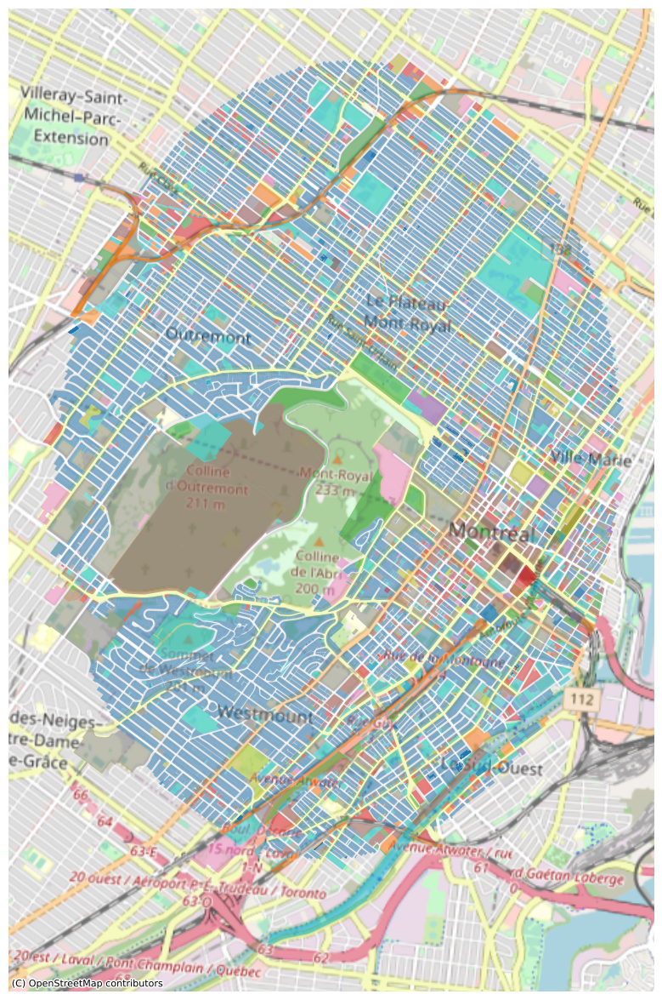

In [91]:
data_PCL_bldg=ut.building_extract(x=-73.589693,y=45.508574,r=0.035)
display(data_PCL_bldg.head())
data_PCL_bldg["landuse_code"]=data_PCL_bldg["landuse_code"].astype("category")
ut.plot_it(buildings_list=data_PCL_bldg,column="landuse_code",legend=False,alpha=0.5)

In [92]:
data_PCL_bldg['ID_UEV']='0' + data_PCL_bldg['uid'].astype(str)


In [28]:
assigned_bldgs=ut.tract_assign(data_PCL_bldg,x=-73.589693,y=45.508574,r=0.01)[0]

Fetching Metadata. Please Wait ...
Tracts collection acquired
selecting 11 tracts in 1111 m radius of point -73.589693,45.508574
check for tract0128.00 which is 1 / 11
check for tract0130.00 which is 2 / 11
check for tract0137.00 which is 3 / 11
check for tract0138.00 which is 4 / 11
check for tract0360.00 which is 5 / 11
check for tract0129.01 which is 6 / 11
check for tract0129.02 which is 7 / 11
check for tract0127.02 which is 8 / 11
check for tract0163.00 which is 9 / 11
check for tract0164.00 which is 10 / 11
check for tract0363.00 which is 11 / 11


In [29]:

assigned_bldgs['Tract'].unique()

array(['0129.01', '0128.00', '0130.00', '0163.00', '0129.02', '0360.00',
       '0137.00', '0138.00', '0164.00', '0127.02', '0363.00'],
      dtype=object)

In [ ]:
data_temp=

there is 'geom' in columns


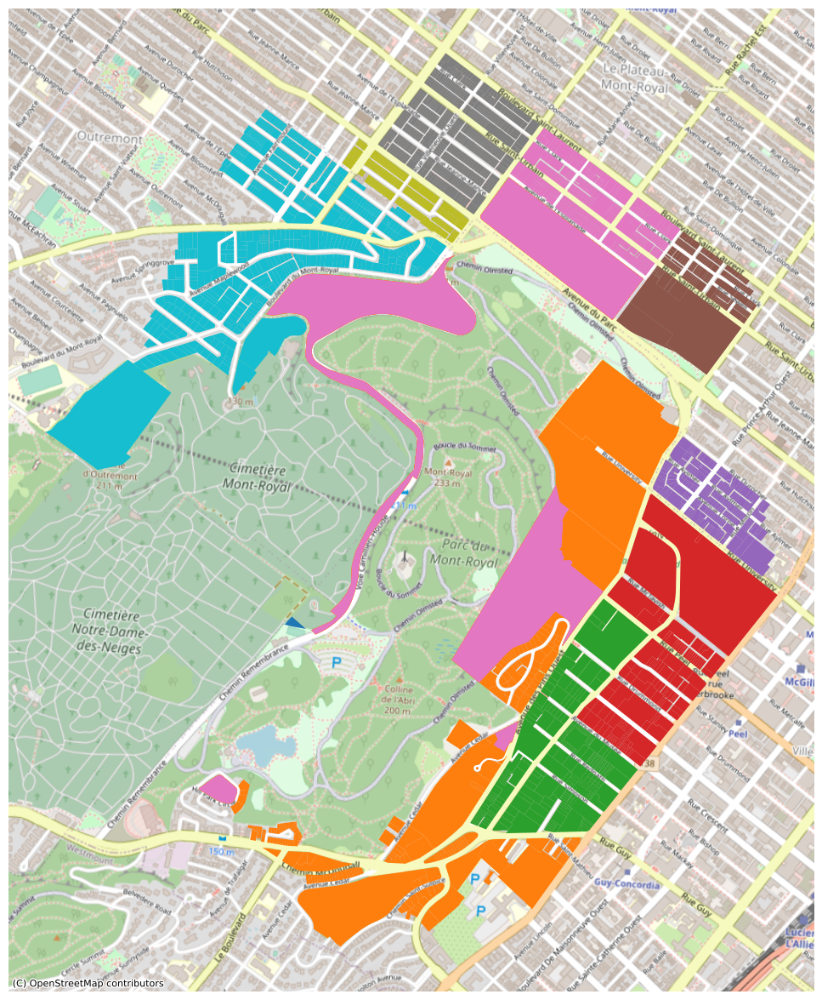

In [30]:
ut.plot_it(assigned_bldgs,column='Tract')

In [12]:
data_Koa=gpd.read_file(r"C:\Users\msham\Downloads\montreal_districts.geojson")
data_Koa

,NOM,TYPE,CODEID,ABREV,NUM,CODEMAMROT,AIRE,MUNID,PERIM,geometry
0,Outremont,Arrondissement,11,OM,5,REM05,3.813356e+06,66023,10836.670634,"MULTIPOLYGON (((-73.62078 45.52365, -73.62079 ..."
1,LaSalle,Arrondissement,22,LS,18,REM17,2.519727e+07,66023,25259.849467,"MULTIPOLYGON (((-73.66610 45.42180, -73.66531 ..."
2,Mont-Royal,Ville liée,62,MR,2,66072,7.445560e+06,66023,18314.038523,"MULTIPOLYGON (((-73.65075 45.52631, -73.65126 ..."
3,Ville-Marie,Arrondissement,9,VM,20,REM19,2.150063e+07,66023,26585.959852,"MULTIPOLYGON (((-73.53013 45.53476, -73.53543 ..."
4,Le Plateau-Mont-Royal,Arrondissement,5,PM,22,REM21,8.151665e+06,66023,13158.328007,"MULTIPOLYGON (((-73.55923 45.53990, -73.56105 ..."
5,Hampstead,Ville liée,54,HS,10,66062,1.768055e+06,66023,5875.848917,"MULTIPOLYGON (((-73.65601 45.47893, -73.65084 ..."
6,Le Sud-Ouest,Arrondissement,63,SO,21,REM20,1.814427e+07,66023,29633.161330,"MULTIPOLYGON (((-73.62908 45.44839, -73.62881 ..."
7,Rivière-des-Prairies-Pointe-aux-Trembles,Arrondissement,57,RP,19,REM33,5.004700e+07,66023,38573.067638,"MULTIPOLYGON (((-73.62475 45.63359, -73.62070 ..."
8,Lachine,Arrondissement,28,LC,17,REM27,2.312779e+07,66023,25399.526011,"MULTIPOLYGON (((-73.72299 45.42179, -73.72184 ..."
9,Dorval,Ville liée,51,DV,1,66087,2.815615e+07,66023,32357.566810,"MULTIPOLYGON (((-73.79470 45.48181, -73.79015 ..."


In [ ]:
data_Koa_selected_districts=data_Koa[data_Koa['CODEID'].isin(["9","5","11"])]
data_Koa_selected_districts

there is 'geom' in columns


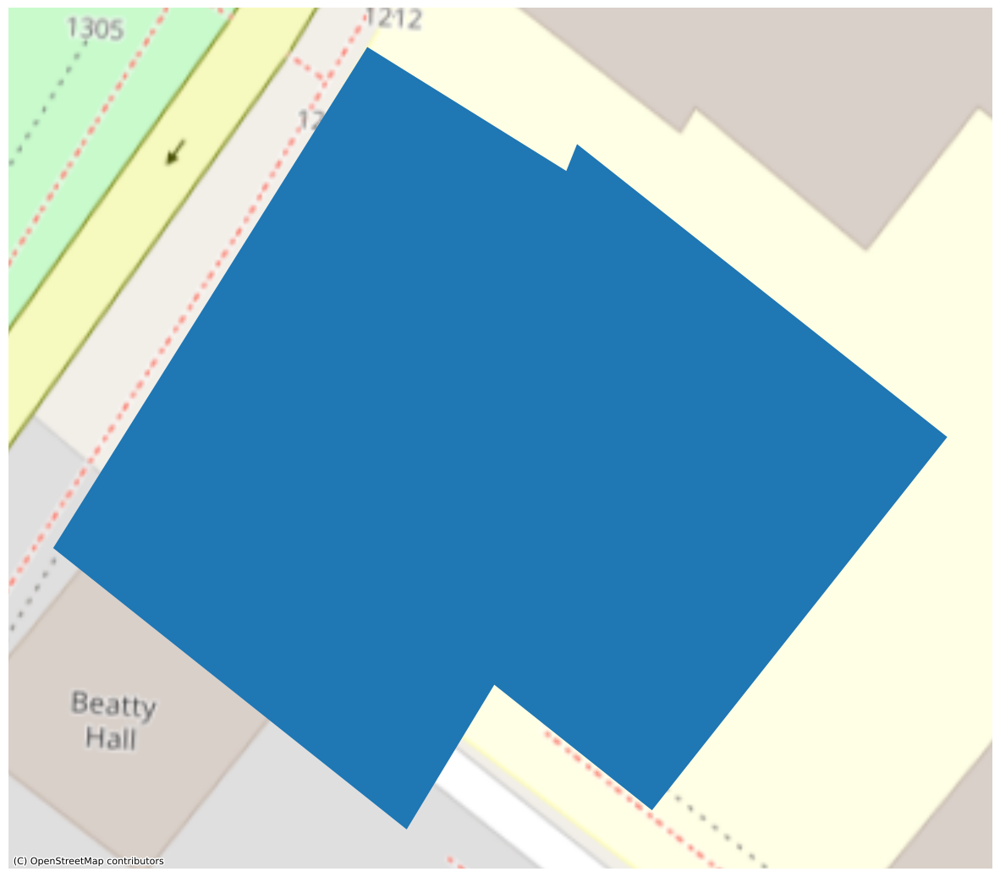

In [36]:
ut.plot_it(assigned_bldgs.head(1))

In [39]:
selected_bldg=assigned_bldgs.head(1)

In [44]:
selected_bldg.loc[:,'geometry'].values

<GeometryArray>
[<POLYGON ((-73.584 45.502, -73.584 45.502, -73.584 45.502, -73.583 45.502, -...>]
Length: 1, dtype: geometry

In [54]:
polya.contains(polyb)

False

In [72]:
Buildings_list=assigned_bldgs

for j in tqdm(Buildings_list.index, disable=True):
    polyb=Polygon(Buildings_list.iloc[j,:]["geometry"])


100%|██████████| 2454/2454 [00:00<00:00, 6640.23it/s]


check for District11 which is 1 / 3


100%|██████████| 480243/480243 [21:05<00:00, 379.57it/s] 


check for District9 which is 2 / 3


100%|██████████| 480243/480243 [21:52<00:00, 365.94it/s] 


check for District5 which is 3 / 3


100%|██████████| 480243/480243 [24:07<00:00, 331.87it/s]  


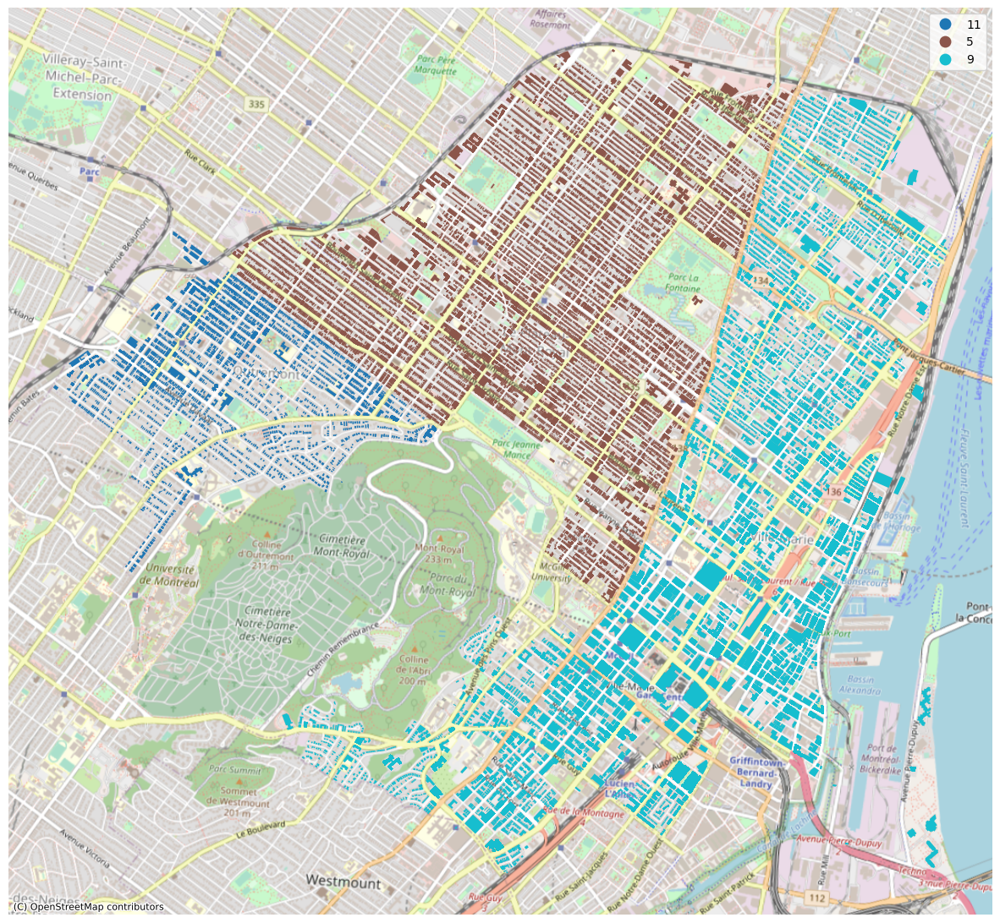

In [102]:
Buildings_list=montreal_dataset
tracts_assigned_dict=[]

for i, CODEID in enumerate(data_Koa_selected_districts["CODEID"]):
    
    polya=MultiPolygon(data_Koa_selected_districts[data_Koa_selected_districts['CODEID']==CODEID].iloc[0,:]['geometry'])
    print(f"check for District{CODEID} which is {i+1} / {len(data_Koa_selected_districts)}")
    for j in tqdm(Buildings_list.index, disable=False):
        if "MULTIPOLYGON" in str(Buildings_list[Buildings_list.index==j]["geometry"]):
            continue
        polyb=Polygon(Buildings_list.iloc[j,:]["geometry"])
        if polya.contains(polyb):
            tracts_assigned_dict.append({'Index':j,'ID_UEV':str(Buildings_list.iloc[j,:]["ID_UEV"]),'District':CODEID})

new_df=Buildings_list.copy()
tracts_assigned_df=pd.DataFrame(tracts_assigned_dict)
new_df=pd.merge(new_df,tracts_assigned_df,on="ID_UEV")
ut.plot_it(new_df,column='District',legend=True)

In [82]:
new_df

,borough_id,building_number,built_area,dwelling_number,firstletter_apt,geom,index,land_area,landuse_code,landuse_text,...,street_name,street_number,uid,unit_category,unit_number,year_built,geometry,ID_UEV,Index,District
0,REM19,1250,253,1,0,"{'type': 'Polygon', 'crs': {'type': 'name', 'p...",0,34,1000,Logement,...,avenue des Pins Ouest (MTL),1250,1038640,Condominium,1040,1979,"POLYGON ((-73.58364 45.50248, -73.58392 45.502...",01038640,0,9
1,REM19,3577,2824,1,0,"{'type': 'Polygon', 'crs': {'type': 'name', 'p...",5,76,1000,Logement,...,avenue Atwater (MTL+WMT),3577,1038232,Condominium,1214,1983,"POLYGON ((-73.58916 45.49369, -73.58919 45.493...",01038232,1,9
2,REM19,3480,407,1,0,"{'type': 'Polygon', 'crs': {'type': 'name', 'p...",16,17,1000,Logement,...,rue Simpson (MTL),3480,1039817,Condominium,808,1972,"POLYGON ((-73.58405 45.49847, -73.58416 45.498...",01039817,2,9
3,REM21,3634,221,6,0,"{'type': 'Polygon', 'crs': {'type': 'name', 'p...",37,424,1000,Logement,...,rue Lorne-Crescent (MTL),3634,1038394,Régulier,0,1890,"POLYGON ((-73.57925 45.50837, -73.57902 45.508...",01038394,3,5
4,REM21,205,441,3,0,"{'type': 'Polygon', 'crs': {'type': 'name', 'p...",51,232,1000,Logement,...,boulevard Saint-Joseph Ouest (MTL+OUT),209,1002631,Régulier,0,1910,"POLYGON ((-73.59346 45.52030, -73.59379 45.520...",01002631,4,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5239,REM21,4829,129,1,0,"{'type': 'Polygon', 'crs': {'type': 'name', 'p...",338120,107,1000,Logement,...,rue De Bullion (MTL),4829,1001683,Régulier,0,1900,"POLYGON ((-73.58850 45.52341, -73.58855 45.523...",01001683,3866,5
5240,REM21,3714,0,0,0,"{'type': 'Polygon', 'crs': {'type': 'name', 'p...",338417,90,5821,Établissement avec service de boissons alcooli...,...,avenue du Parc (MTL),3714,1125588,Condominium,0,1904,"POLYGON ((-73.57803 45.51106, -73.57805 45.511...",01125588,3867,5
5241,REM21,3449,16663,0,0,"{'type': 'Polygon', 'crs': {'type': 'name', 'p...",338437,10416,6812,École élémentaire,...,rue University (MTL),3449,1037849,Régulier,0,1914,"POLYGON ((-73.57496 45.50679, -73.57563 45.506...",01037849,3868,5
5242,REM19,1025,9569,0,0,"{'type': 'Polygon', 'crs': {'type': 'name', 'p...",338441,36611,6513,Service d'hôpital (inclus hôpitaux psychiatriq...,...,avenue des Pins Ouest (MTL),1025,1003713,Régulier,0,9999,"POLYGON ((-73.58386 45.50733, -73.58403 45.507...",01003713,3869,9


there is 'geom' in columns


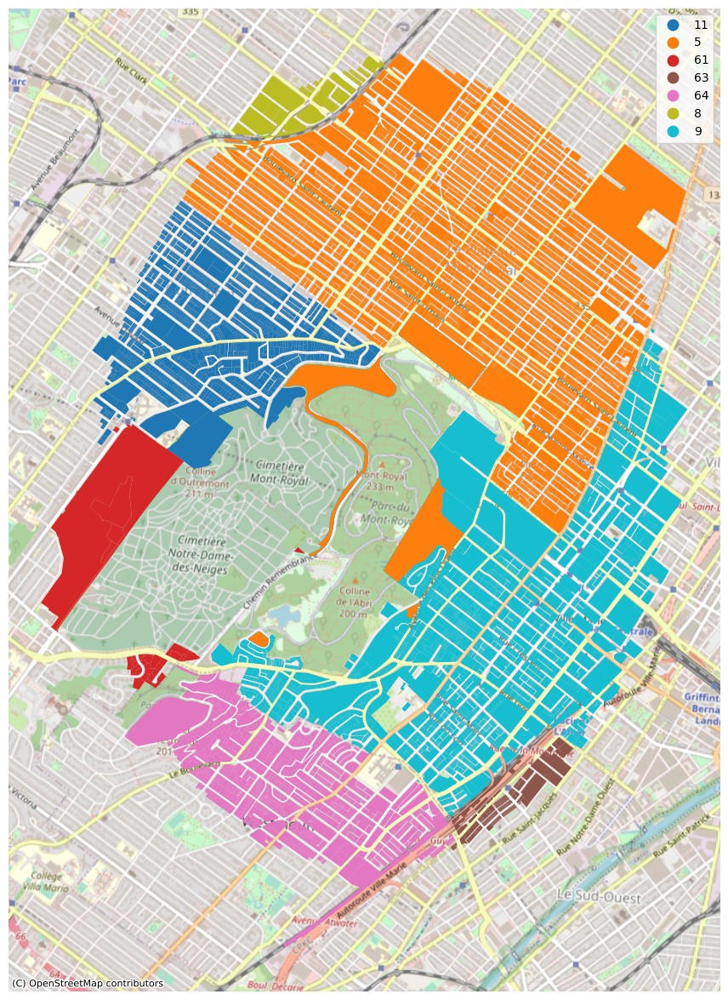

In [90]:
ut.plot_it(new_df,column='District',legend=True)

In [101]:
for i, CODEID in enumerate(data_Koa_selected_districts["CODEID"]):
    
    polya=MultiPolygon(data_Koa_selected_districts[data_Koa_selected_districts['CODEID']==CODEID].iloc[0,:]['geometry'])
    print(f"check for tract{CTname} which is {i+1} / {len(data_tracts)}")
    for j in tqdm(Buildings_list.index, disable=True):
        if "MULTIPOLYGON" in str(Buildings_list[Buildings_list.index==j]["geometry"]):
            continue
        polyb=Polygon(Buildings_list.iloc[j,:]["geometry"])
        if polya.contains(polyb):
            tracts_assigned_dict.append({'Index':j,'ID_UEV':str(Buildings_list.iloc[j,:]["ID_UEV"]),'Tract':CTname})

new_df=Buildings_list.copy()
tracts_assigned_df=pd.DataFrame(tracts_assigned_dict)
new_df=pd.merge(new_df,tracts_assigned_df,on="ID_UEV")

NameError: name 'CTname' is not defined

In [46]:
type(polyb)

pandas.core.series.Series

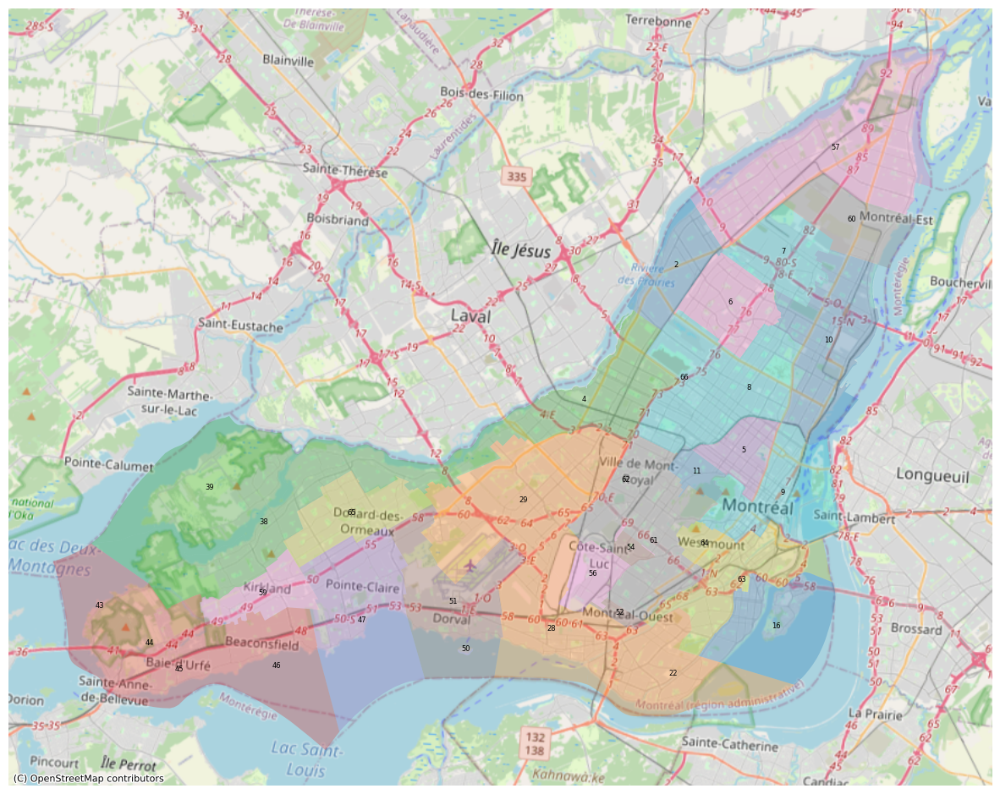

In [15]:
ut.plot_it(data_Koa,alpha=0.3,column='CODEID',labeled=True)

,NOM,TYPE,CODEID,ABREV,NUM,CODEMAMROT,AIRE,MUNID,PERIM,geometry
0,Outremont,Arrondissement,11,OM,5,REM05,3.813356e+06,66023,10836.670634,"MULTIPOLYGON (((-73.62078 45.52365, -73.62079 ..."
3,Ville-Marie,Arrondissement,9,VM,20,REM19,2.150063e+07,66023,26585.959852,"MULTIPOLYGON (((-73.53013 45.53476, -73.53543 ..."
4,Le Plateau-Mont-Royal,Arrondissement,5,PM,22,REM21,8.151665e+06,66023,13158.328007,"MULTIPOLYGON (((-73.55923 45.53990, -73.56105 ..."


In [94]:
montreal_dataset=gpd.read_file(r"C:\Users\msham\OneDrive\Documents\GitHub\Montreal Dataset - gitea\montreal_dataset\montreal_dataset_v1.geojson")

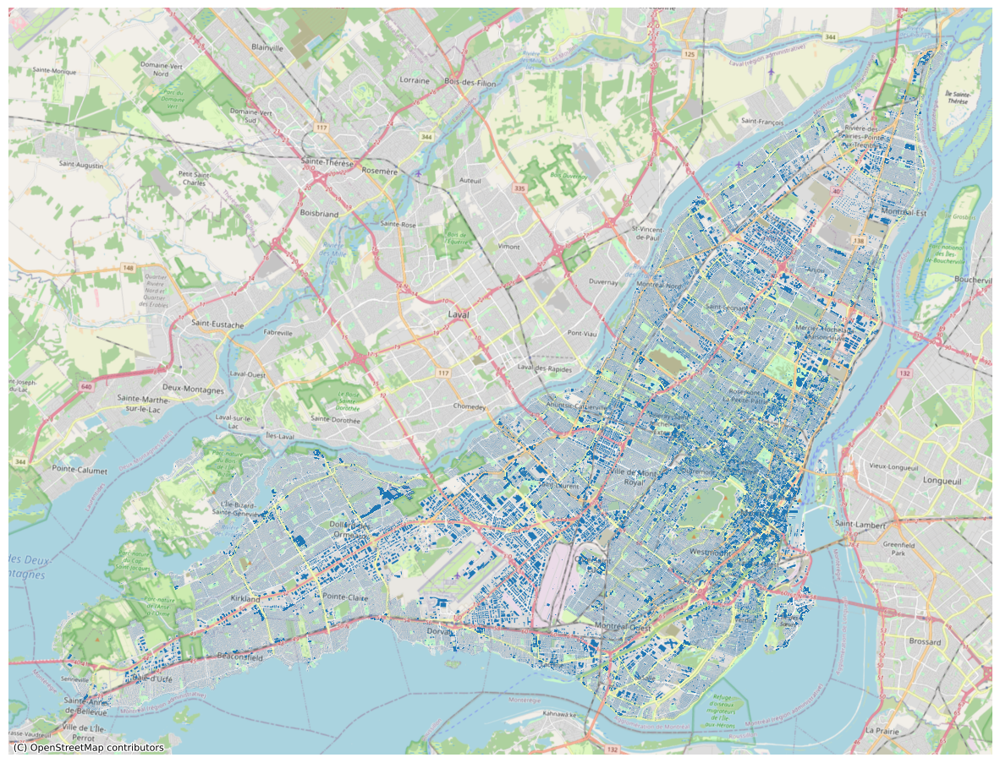

In [96]:
ut.plot_it(montreal_dataset)

Fetching Metadata. Please Wait ...
Tracts collection acquired
selecting 66 tracts in 2222 m radius of point -73.576861,45.513616
there is 'geom' in columns


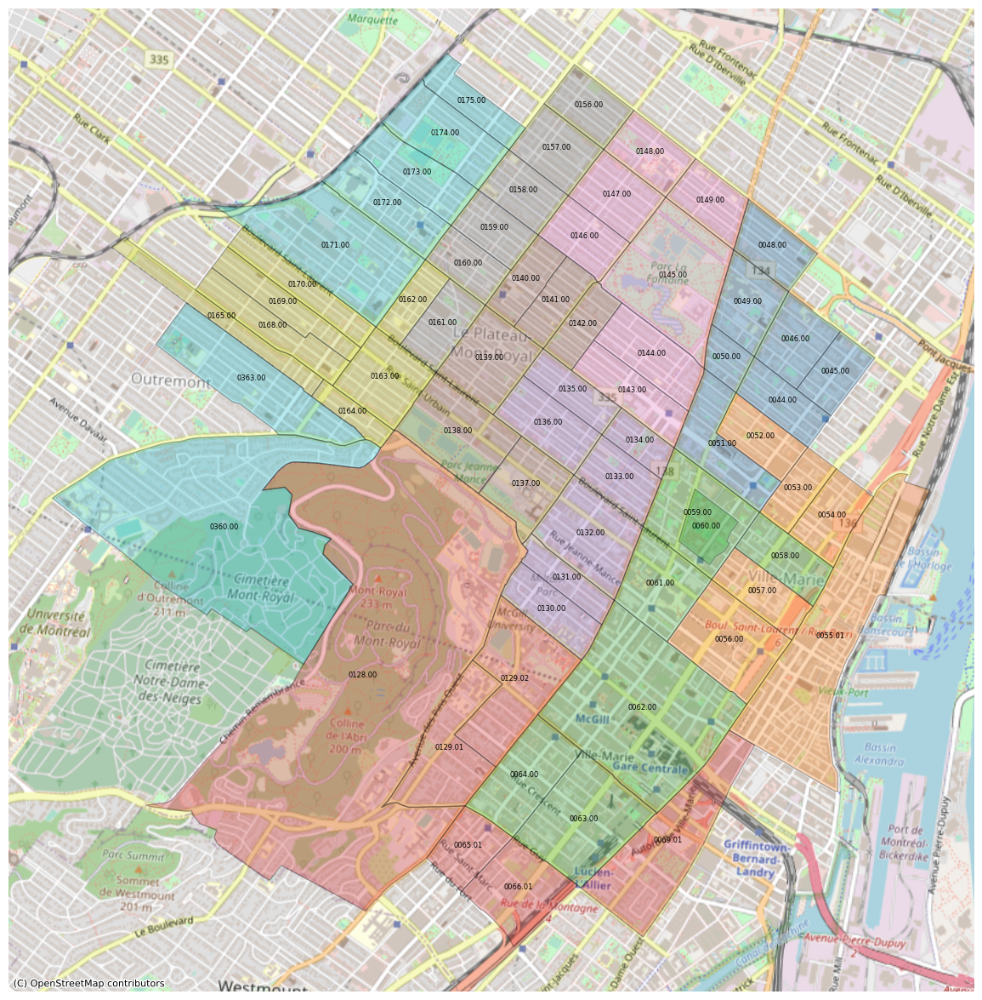

In [11]:
ut.plot_it(ut.tract_extract(x=-73.576861,y=45.513616,r=0.02),multipolygon=True,alpha=0.3,column="CTNAME",labeled=True)

In [29]:
data_building_lots=ut.building_extract(x=-73.589693,y=45.508574,r=0.032)
data_building_lots.head()

Fetching Metadata. Please Wait ...
building lots collection acquired
selecting 28802 buildings in 3555 m radius of point -73.589693,45.508574


,borough_id,building_number,built_area,dwelling_number,firstletter_apt,geom,index,land_area,landuse_code,landuse_text,lastletter_apt,max_floors,municipality_code,nad83_registration,street_name,street_number,uid,unit_category,unit_number,year_built
0,REM19,1250,253,1,0,"{'type': 'Polygon', 'crs': {'type': 'name', 'p...",0,34,1000,Logement,0,0,50,9840-22-7858-8-001-0103,avenue des Pins Ouest (MTL),1250,1038640,Condominium,1040,1979
1,REM19,3577,2824,1,0,"{'type': 'Polygon', 'crs': {'type': 'name', 'p...",5,76,1000,Logement,0,1,50,9739-83-9737-8-001-0302,avenue Atwater (MTL+WMT),3577,1038232,Condominium,1214,1983
2,REM19,2212,354,6,0,"{'type': 'Polygon', 'crs': {'type': 'name', 'p...",8,178,1000,Logement,0,3,50,9838-19-9094-8-000-0000,boulevard De Maisonneuve Ouest (MTL+WMT),2214,1037770,Régulier,0,1900
3,REM19,2208,198,1,0,"{'type': 'Polygon', 'crs': {'type': 'name', 'p...",9,173,1000,Logement,0,2,50,9838-19-9599-6-000-0000,boulevard De Maisonneuve Ouest (MTL+WMT),2208,1037771,Régulier,0,1900
4,REM19,2204,189,1,0,"{'type': 'Polygon', 'crs': {'type': 'name', 'p...",10,166,1000,Logement,0,2,50,9839-10-9905-2-000-0000,boulevard De Maisonneuve Ouest (MTL+WMT),2206,1037773,Régulier,0,1900


there is 'geom' in columns


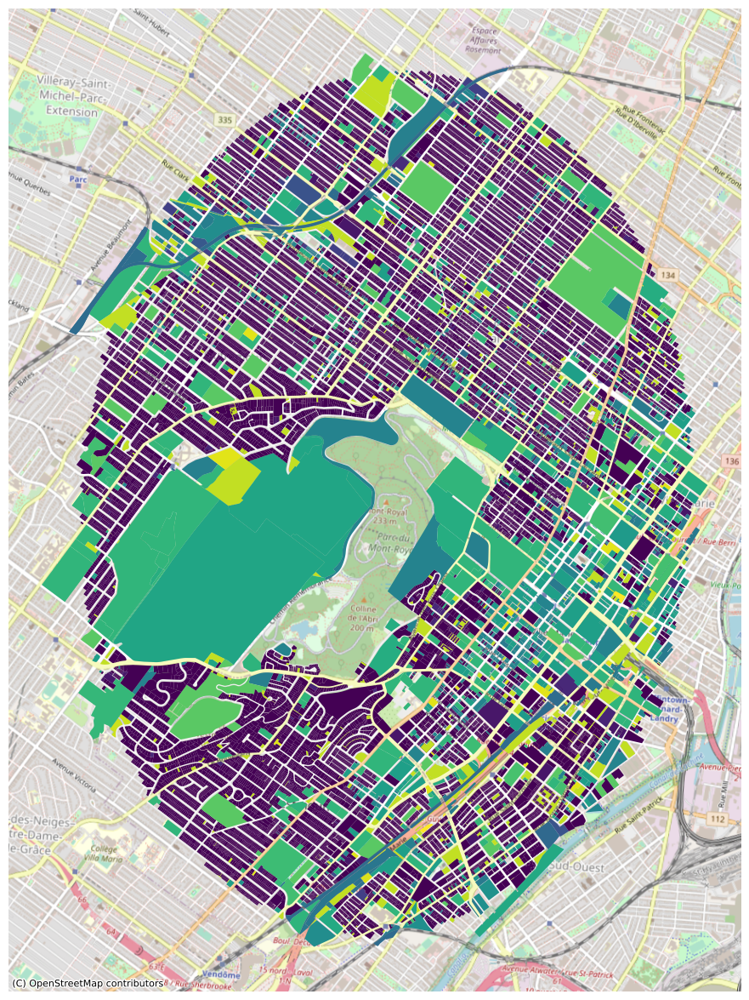

In [31]:
ut.plot_it(data_building_lots,column='landuse_code')

In [27]:
postal_codes_extracted=pd.read_csv(r'C:\Users\msham\OneDrive\Documents\GitHub\hydro-quebec-scrapper\saved_postal_codes.csv')
postal_codes_extracted

,index,uid,street_number,postal_code
0,90,1034308,2029.0,H2H 1J7
1,92,1034311,2023.0,H2H 1J7
2,93,1034313,2017.0,H2H 1J7
3,136,1034340,1843.0,H2H 1W8
4,137,1034342,1831.0,H2H 1J2
...,...,...,...,...
5533,328837,3036125,455.0,H2V 3M4
5534,334290,5085195,660.0,H2V 1S8
5535,337767,3033912,381.0,H2V 3W1
5536,337768,3033912,381.0,H2V 3W1


there is 'geom' in columns


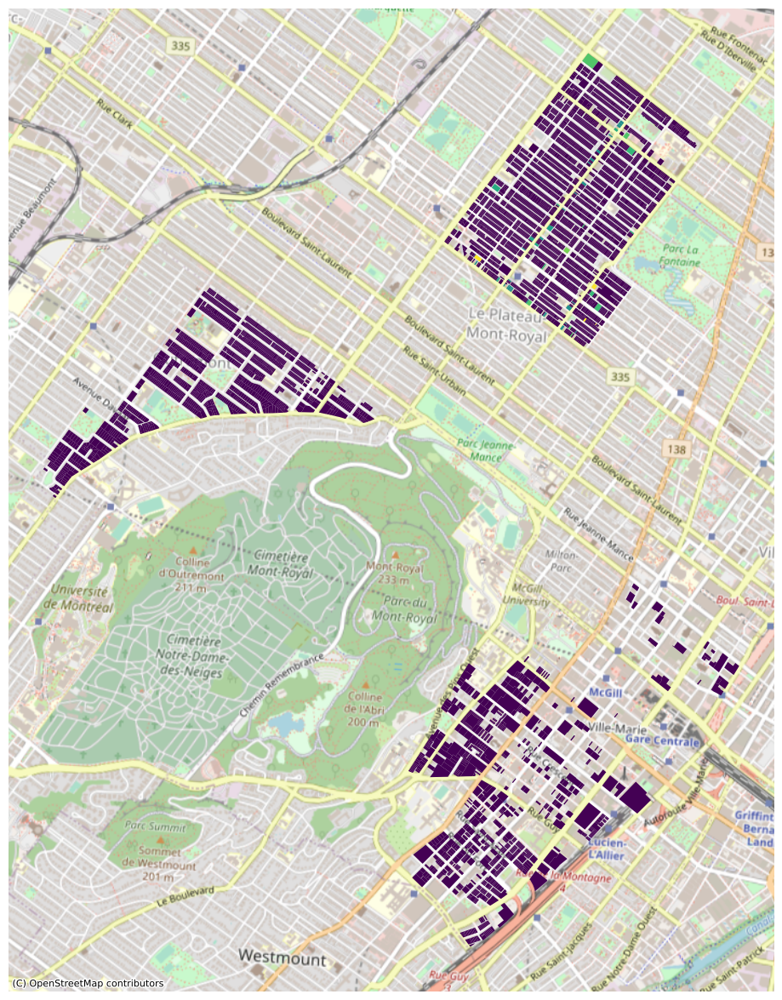

In [33]:
mask=data_building_lots['uid'].isin(postal_codes_extracted['uid'])
ut.plot_it(data_building_lots[mask],column='landuse_code')

In [7]:
def plot_it(buildings_list,column=None,legend=False,basemap=True,multipolygon=False,alpha=1):
    if type(buildings_list)!=gpd.geodataframe.GeoDataFrame:
        dataset=geodataframe_of(buildings_list,multipolygon)
        # dataset=gpd.GeoDataFrame(buildings_list)
        # dataset=dataset.set_geometry(geometry_generator(buildings_list,multipolygon=multipolygon))
        # dataset=dataset.set_crs(epsg=4326)
    else:
        dataset=buildings_list
    dataset=dataset.to_crs('EPSG:32198')
    if multipolygon:
        ax=dataset.plot(column=column,legend=legend, edgecolor="black", alpha=alpha,figsize=(10, 10))
    else:
        ax=dataset.plot(column=column,legend=legend,alpha=alpha,figsize=(10, 10))
    if basemap:
        cx.add_basemap(ax, crs=dataset.crs.to_string(),source=cx.providers.OpenStreetMap.Mapnik)
    
    return

def geometry_generator(bldgs,multipolygon=False):
    polygon_list=[]
    for i in range(len(bldgs)):
        if multipolygon:
            vertex = bldgs.iloc[i,:]["geom"]["coordinates"][0][0]
        else:    
            vertex = bldgs.iloc[i,:]["geom"]["coordinates"][0]
        polygon1=Polygon(vertex)
        polygon_list.append(polygon1)
    return polygon_list

def geodataframe_of(buildings_list,multipolygon=False,crs='EPSG:32198'):
    if 'geom' in buildings_list.columns:
        print("there is 'geom' in columns")
        buildings_list_gdf=gpd.GeoDataFrame(buildings_list,geometry=geometry_generator(buildings_list,multipolygon=multipolygon),crs='epsg:4326').to_crs(crs)
    elif 'geometry' in buildings_list.columns:
        print('there is "geometry" in columns')
        buildings_list_gdf=gpd.GeoDataFrame(buildings_list,geometry=buildings_list.geometry,crs='epsg:4326').to_crs(crs)
    else:
        print('no geometry detected')
        buildings_list_gdf=[]
    return buildings_list_gdf

there is 'geom' in columns


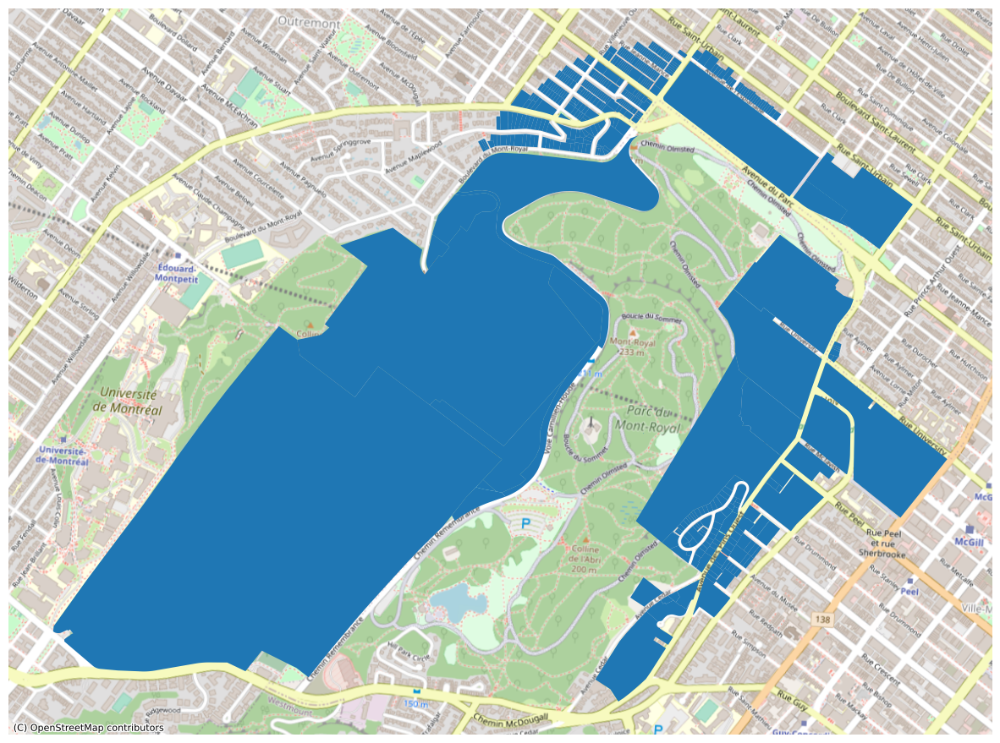

In [3]:
ut.plot_it(data_building_lots)

In [4]:
K_buildings=gpd.read_file("Masood_data2_FeaturesToJSON.geojson")


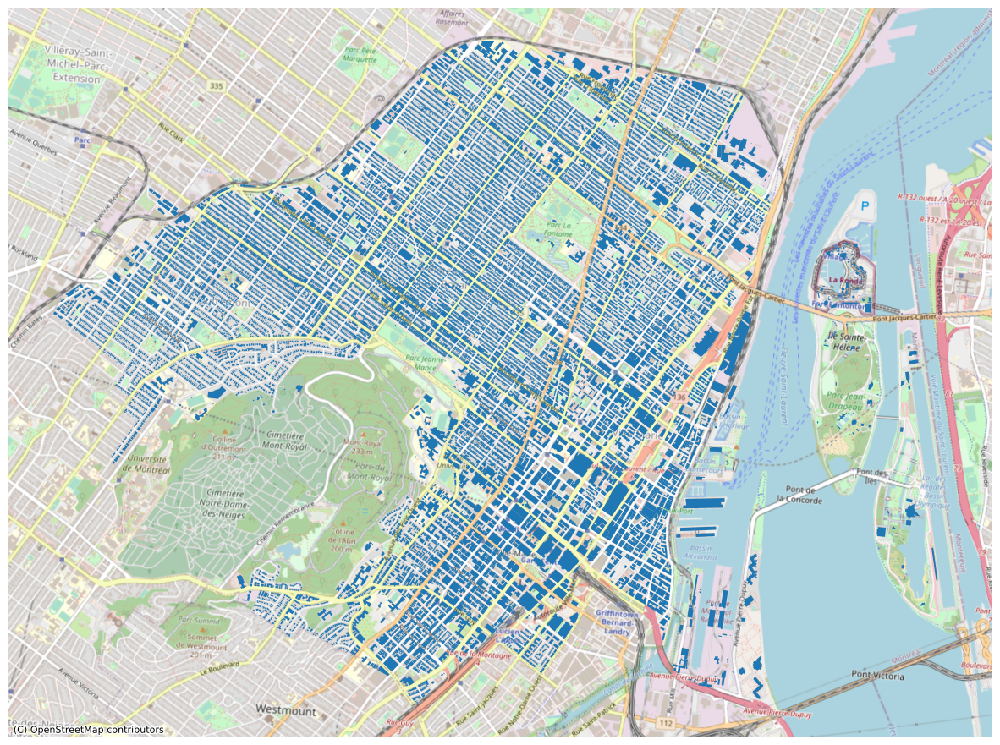

In [5]:
ut.plot_it(K_buildings)

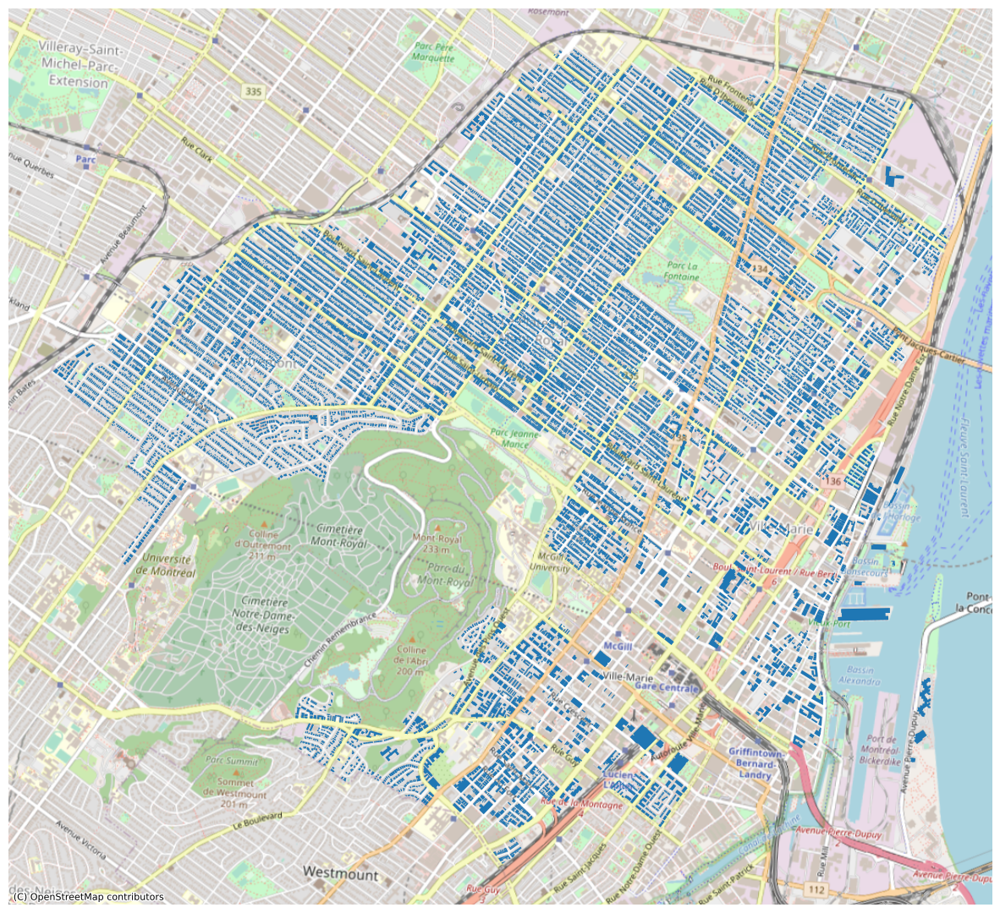

In [7]:
# residentials

ut.plot_it(K_buildings.loc[K_buildings['CODE_UTILI']=='1000',:])

In [8]:
for i in range(300):
    candidate_bldgs=K_buildings
    if os.path.isfile('bldg_tract_list.csv'):
        tract_list_2=pd.read_csv('bldg_tract_list.csv',dtype=str)
        mask=candidate_bldgs['ID_UEV'].isin(tract_list_2['ID_UEV'])
        candidate_bldgs_2=candidate_bldgs[~mask]
    else:
        candidate_bldgs_2=candidate_bldgs
    if len(candidate_bldgs_2)>500:
        print(f"total buildings wo/ tracts: {len(candidate_bldgs_2)}")
        candidate_bldgs_2=candidate_bldgs_2.sample(500).reset_index()
    print(f"selected # of buildings: {len(candidate_bldgs_2)}")
    candidate_bldgs_tracted,tract_list=ut.tract_assign(candidate_bldgs_2,x=-73.576506,y=45.514217,r=0.05)
    tract_list_2=pd.concat([tract_list_2,tract_list],axis=0)
    tract_list_2.to_csv('bldg_tract_list.csv',index=False)

selected # of buildings: 223
Fetching Metadata. Please Wait ...
Tracts collection acquired
selecting 210 tracts in 5555 m radius of point -73.576506,45.514217
check for tract0137.00 which is 1 / 210


IndexError: single positional indexer is out-of-bounds

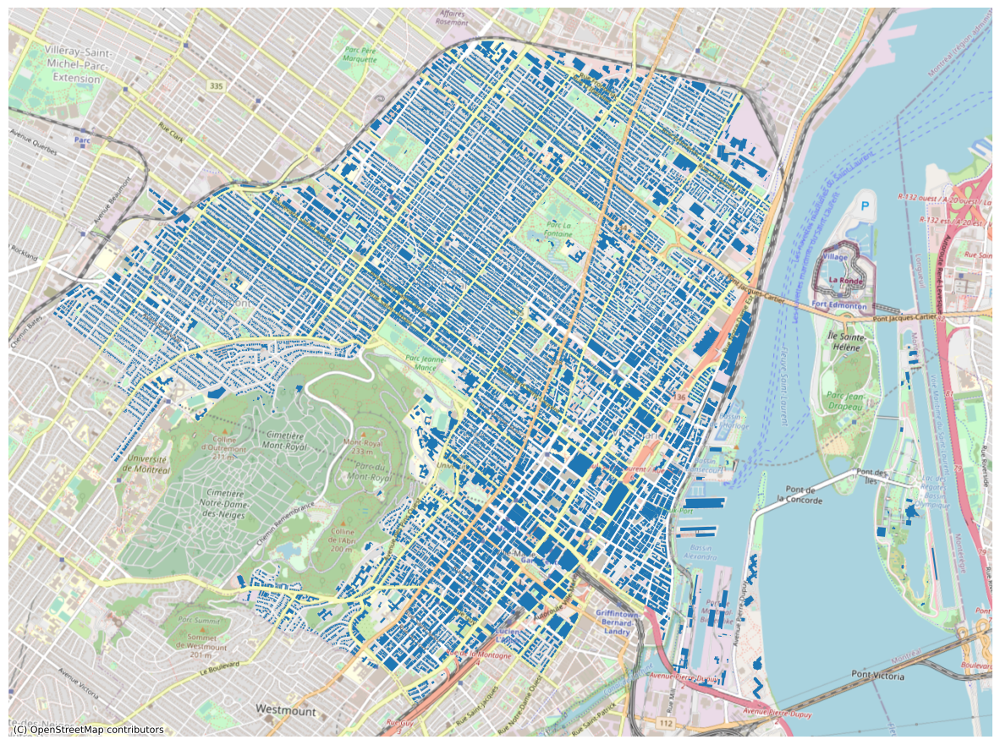

In [9]:
tract_list_2=pd.read_csv('bldg_tract_list.csv',dtype=str)
mask2=K_buildings['ID_UEV'].isin(tract_list_2['ID_UEV'])
ut.plot_it(K_buildings[mask2])

In [18]:
K_buildings[mask2].shape

(33380, 22)

In [10]:
K_buildings[~mask2]

,FID,Z_Min,Z_Max,Z_Mean,ID_UEV,NOM_RUE,ETAGE_HORS,NOMBRE_LOG,ANNEE_CONS,CODE_UTILI,...,elevmin,elevmax,bldgarea,g_usag_pre,NewHieght,New_Area,ORIG_FID,Shape_Leng,Shape_Area,geometry
17735,17735,51.26,63.29,61.889279,01034717,boulevard Saint-Joseph Est (MTL),3,0,1924,1000,...,50.82,51.97,187.73,Résidentiel,11,101,85911,0.000473,1.160938e-08,"POLYGON ((-73.57784 45.53731, -73.57779 45.537..."
19026,19026,75.02,93.02,85.413557,01002394,boulevard Saint-Joseph Ouest (MTL+OUT),3,0,1910,1000,...,73.25,75.69,900.46,Résidentiel,17,155,92373,0.000647,1.782106e-08,"POLYGON ((-73.59496 45.51788, -73.59496 45.517..."
19980,19980,66.18,81.48,70.970119,01029782,rue Waverly (MTL),1,0,1910,1000,...,65.19,68.60,6312.19,Résidentiel,13,121,93786,0.000649,1.392252e-08,"POLYGON ((-73.60785 45.52726, -73.60790 45.527..."
20202,20202,66.29,77.70,73.833667,01030230,rue Waverly (MTL),2,0,1910,1000,...,65.35,67.13,3913.55,Résidentiel,11,98,94012,0.000445,1.125642e-08,"POLYGON ((-73.60571 45.52668, -73.60579 45.526..."
20727,20727,68.90,81.88,78.192904,03114645,avenue Champagneur (OUT),1,0,1913,1000,...,68.03,69.23,777.68,Résidentiel,13,147,97683,0.000696,1.698383e-08,"POLYGON ((-73.61272 45.52199, -73.61278 45.522..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33224,33224,25.67,35.88,34.521880,01115336,avenue De Lorimier (MTL),3,0,1900,1000,...,22.11,23.80,2625.84,Résidentiel,12,108,263743,0.000537,1.246386e-08,"POLYGON ((-73.55502 45.52739, -73.55506 45.527..."
33225,33225,25.77,35.85,34.380566,01115337,avenue De Lorimier (MTL),3,0,1900,1000,...,22.11,23.80,2625.84,Résidentiel,12,101,263744,0.000536,1.162433e-08,"POLYGON ((-73.55513 45.52738, -73.55517 45.527..."
33226,33226,25.78,35.79,34.573332,01115338,avenue De Lorimier (MTL),3,0,1900,1000,...,22.11,23.80,2625.84,Résidentiel,12,109,263745,0.000538,1.257834e-08,"POLYGON ((-73.55516 45.52746, -73.55521 45.527..."
33353,33353,28.01,32.62,29.899378,01025387,rue Florian (MTL),1,0,1955,4299,...,20.97,24.10,1007.18,Industrie légère,9,528,264636,0.001012,6.086935e-08,"POLYGON ((-73.55536 45.53890, -73.55562 45.538..."


In [10]:
K_buildings_res=K_buildings.loc[K_buildings['CODE_UTILI']=='1000',:]

In [11]:
tract_list_2

,Index,ID_UEV,Tract
0,19,01035148,0149.00
1,261,05067391,0149.00
2,280,01034798,0149.00
3,369,01034440,0149.00
4,429,05005829,0149.00
...,...,...,...
26335,400,01037450,0066.02
26336,413,01037559,0066.02
26337,421,01002254,0066.02
26338,474,01002678,0066.02


In [13]:
final_df=pd.merge(K_buildings[mask2],tract_list_2,on='ID_UEV')

In [17]:
final_df

,FID,Z_Min,Z_Max,Z_Mean,ID_UEV,NOM_RUE,ETAGE_HORS,NOMBRE_LOG,ANNEE_CONS,CODE_UTILI,...,bldgarea,g_usag_pre,NewHieght,New_Area,ORIG_FID,Shape_Leng,Shape_Area,geometry,Index,Tract
0,0,46.35,58.62,53.703230,01034311,avenue du Mont-Royal Est (MTL),3,0,1900,1000,...,5060.54,Résidentiel,10,227,30937,0.000856,2.618038e-08,"POLYGON ((-73.57286 45.53489, -73.57318 45.535...",160,0156.00
1,1,46.35,60.51,54.938453,01034313,avenue du Mont-Royal Est (MTL),3,0,1926,1000,...,5060.54,Résidentiel,12,227,30938,0.000859,2.619705e-08,"POLYGON ((-73.57291 45.53484, -73.57323 45.534...",26,0156.00
2,2,45.86,69.96,63.604901,01000129,rue Hutchison (MTL+OUT),2,0,1900,1000,...,1565.69,Résidentiel,24,8,30939,0.000435,9.536496e-10,"POLYGON ((-73.57329 45.50833, -73.57330 45.508...",1805,0131.00
3,3,45.92,84.33,63.772476,01000132,rue Hutchison (MTL+OUT),3,0,1900,1000,...,1285.24,Résidentiel,38,103,30940,0.000520,1.181612e-08,"POLYGON ((-73.57359 45.50847, -73.57359 45.508...",463,0131.00
4,4,65.88,76.53,73.157252,01002301,rue Villeneuve Ouest (MTL),2,0,1900,1000,...,1365.09,Résidentiel,10,139,30941,0.000665,1.605543e-08,"POLYGON ((-73.59066 45.51961, -73.59081 45.519...",37,0163.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39367,33598,65.35,70.84,69.865417,03034331,chemin Bates (MTL+MTR+OUT),1,0,1964,4299,...,477.74,Transport et infrastructure,7,475,333089,0.001188,5.466536e-08,"POLYGON ((-73.62560 45.51773, -73.62538 45.517...",144,0367.00
39368,33599,67.05,77.35,75.427659,03036520,avenue Pratt (OUT),0,0,1945,6999,...,755.22,Institutionnel,10,755,339287,0.001302,8.698056e-08,"POLYGON ((-73.62657 45.51673, -73.62654 45.516...",88,0367.00
39369,33600,67.42,72.50,70.795996,03059080,chemin Bates (MTL+MTR+OUT),0,0,2008,6919,...,755.22,Institutionnel,5,0,350614,0.000018,3.935628e-12,"POLYGON ((-73.62657 45.51673, -73.62656 45.516...",408,0367.00
39370,33601,69.48,81.44,76.389212,03036518,avenue Pratt (OUT),0,0,1947,3019,...,11.87,Industrie légère,11,12,357742,0.000173,1.362835e-09,"POLYGON ((-73.62569 45.51620, -73.62570 45.516...",112,0367.00


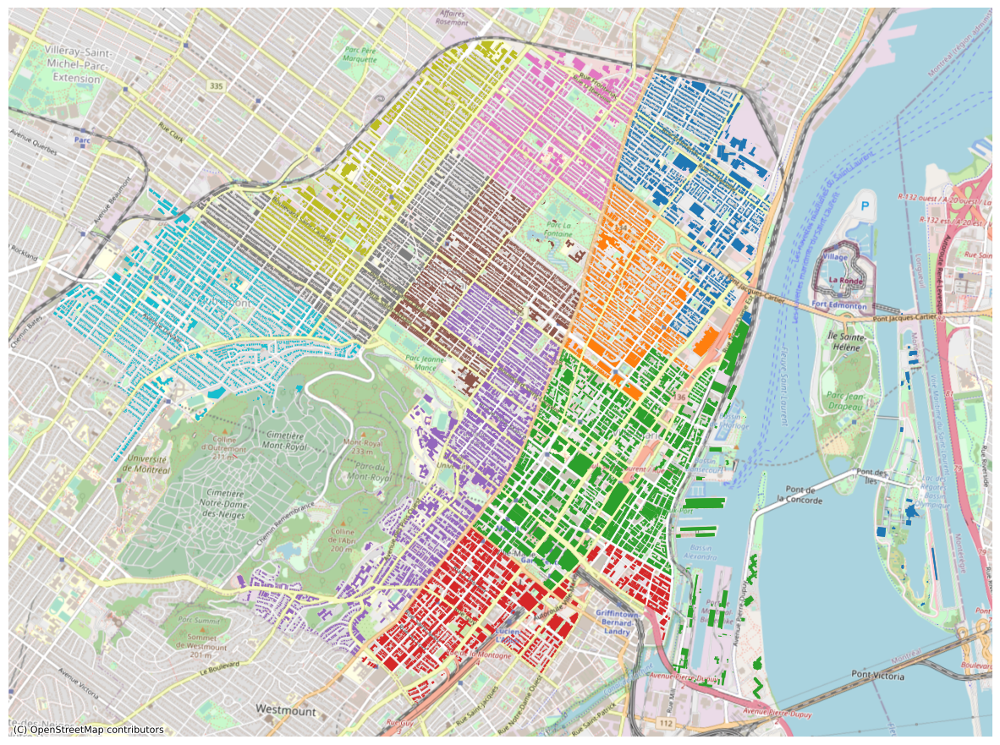

In [25]:
ut.plot_it(final_df,column='Tract')

In [20]:
K_buildings['ID_UEV'].nunique()

26203

In [14]:
final_df['Tract'].value_counts().reset_index()

,index,Tract
0,0132.00,5009
1,0131.00,3617
2,0362.00,903
3,0367.00,865
4,0363.00,812
...,...,...
99,0126.00,5
100,0125.00,3
101,0355.00,2
102,0127.02,1


In [27]:
temp_list=[]
for tract in final_df['Tract'].value_counts().reset_index()['index']:
    # print(tract)
    selected_rows = final_df[final_df['Tract'] == tract].reset_index()
    number_of_unique_indexes_in_the_selected_tract=selected_rows['ID_UEV'].nunique()
    # print(number_of_unique_indexes_in_the_selected_tract)
    temp_list.append({'Tract':tract,'Number of bldgs':number_of_unique_indexes_in_the_selected_tract})
# selected_rows = full_df[full_df['Tract'] == '0157.00'].reset_index()
# selected_rows['Address'].nunique()
tracts_count=pd.DataFrame(temp_list)

In [37]:
tracts_count.loc[tracts_count['Tract']=='0147.00',:]

,Tract,Number of bldgs
16,0147.00,372


Fetching Metadata. Please Wait ...
Tracts collection acquired
selecting 123 tracts in 3333 m radius of point -73.576871,45.525282
there is 'geom' in columns


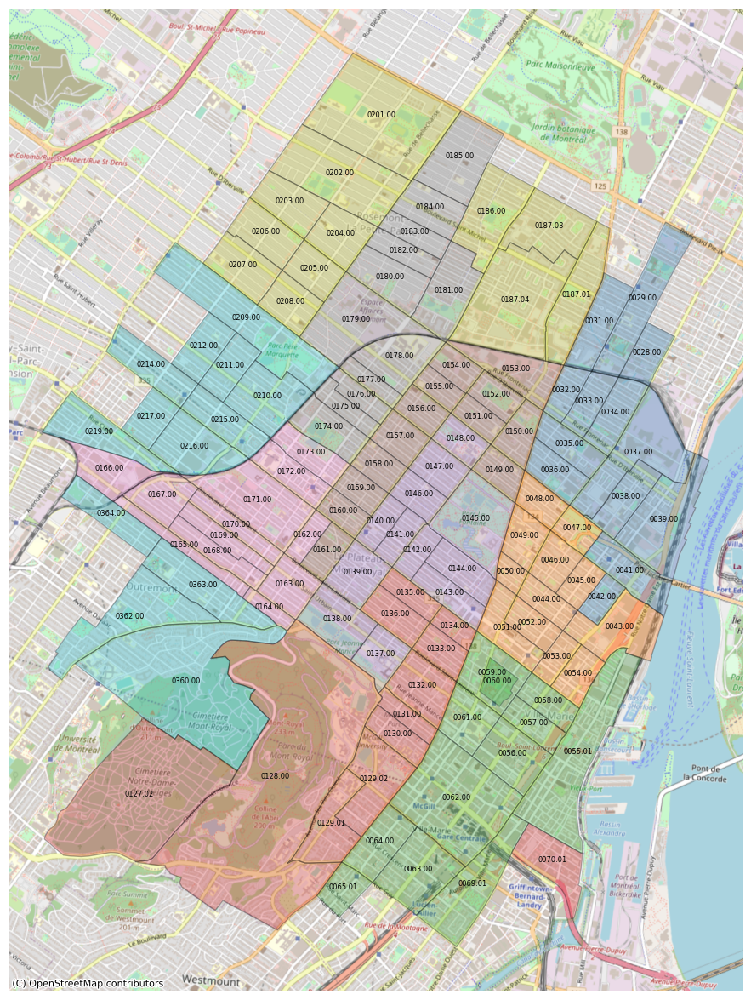

In [39]:
data_tracts=ut.tract_extract(x=-73.576871,y=45.525282,r=0.03)
ut.plot_it(data_tracts,multipolygon=True,alpha=0.3,column="CTNAME",labeled=True)